In [1]:
# imports

import random
from glob import glob

import numpy as np
import torch
from matplotlib import image
from matplotlib import pyplot as plt
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from torchvision.models import resnet50

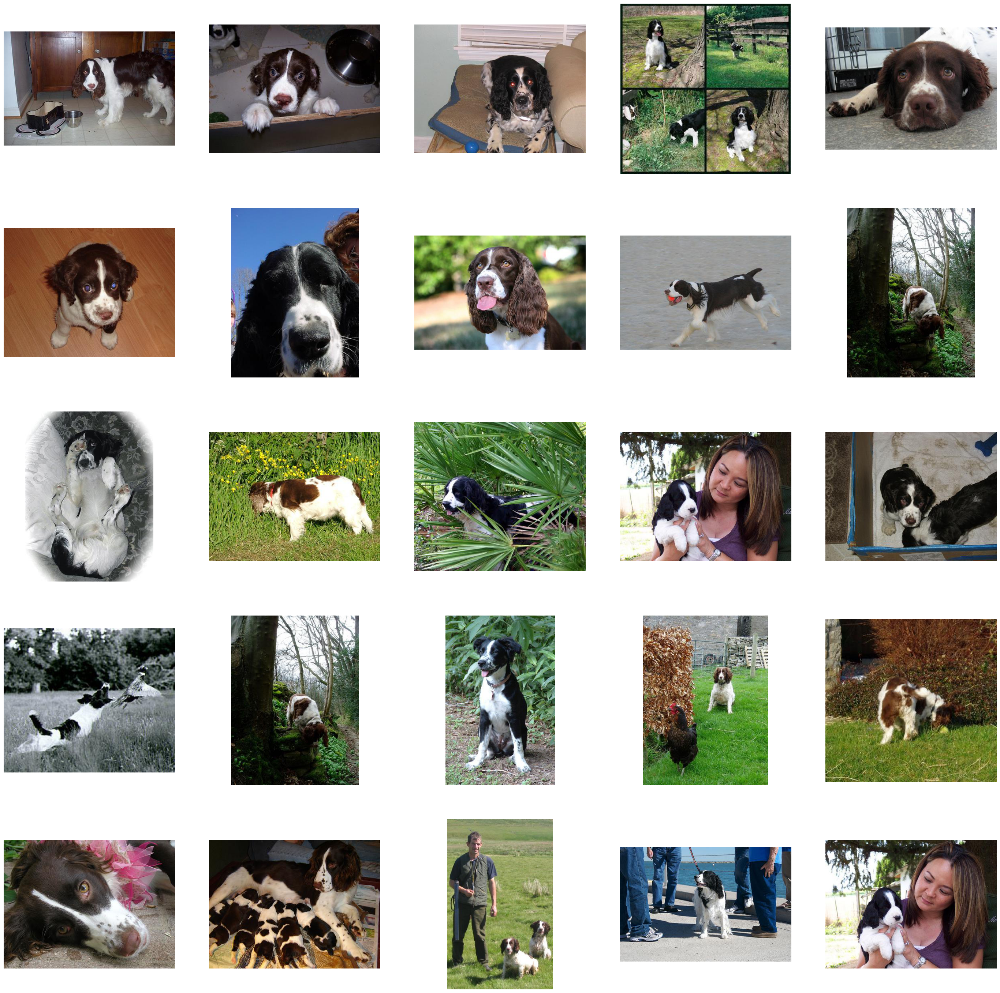

In [2]:
# visualize some images from the Imagenette dataset, from the "Tench" class

image_list_test = glob(
    r"C:\Users\BanbhanAbdulBasit\OneDrive - Johannes Kepler Universität Linz\Studium\Master\1WS2022\XAI\UE\xai_resnet50\pics\imagenette2-320\val\n02102040\*.JPEG"
)
f, axarr = plt.subplots(5, 5, figsize=(35, 35))
for i in range(5):
    for j in range(5):
        axarr[i, j].imshow(image.imread(random.choice(image_list_test)))
        axarr[i, j].axis("off")

plt.show()

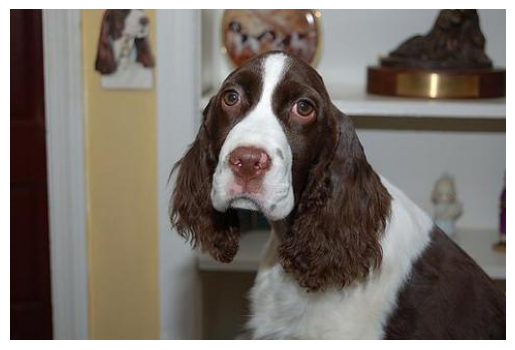

In [3]:
image_test = image.imread(random.choice(image_list_test))

plt.imshow(image_test)
plt.axis("off")
plt.show()

In [4]:
# download ResNet18 and select target layer

model = resnet50(pretrained=True)
target_layers = [model.layer4[-1]]

C:\PROGRA~1\miniconda\envs\py38\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\PROGRA~1\miniconda\envs\py38\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [5]:
# initialize the GradCAM object

cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)

In [6]:
targets = [ClassifierOutputTarget(0)]

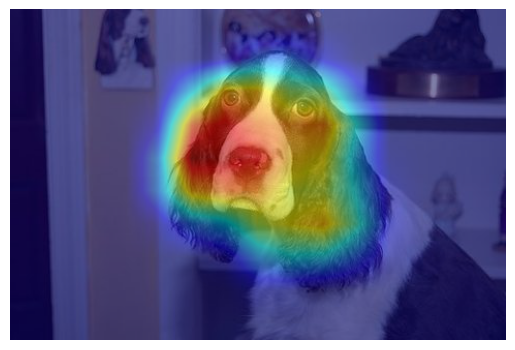

In [7]:
input_tensor = torch.from_numpy(
    np.expand_dims(np.transpose(image_test / 255.0, (2, 0, 1)), 0).astype(np.float32)
)

grayscale_cam = cam(
    input_tensor=input_tensor, targets=targets, aug_smooth=True, eigen_smooth=True
)

grayscale_cam = grayscale_cam[0, :]
visualization = show_cam_on_image(
    np.array(
        image_test / 255,
    ).astype(np.float32),
    grayscale_cam,
    use_rgb=True,
)

plt.imshow(visualization)
plt.axis("off")
plt.show()

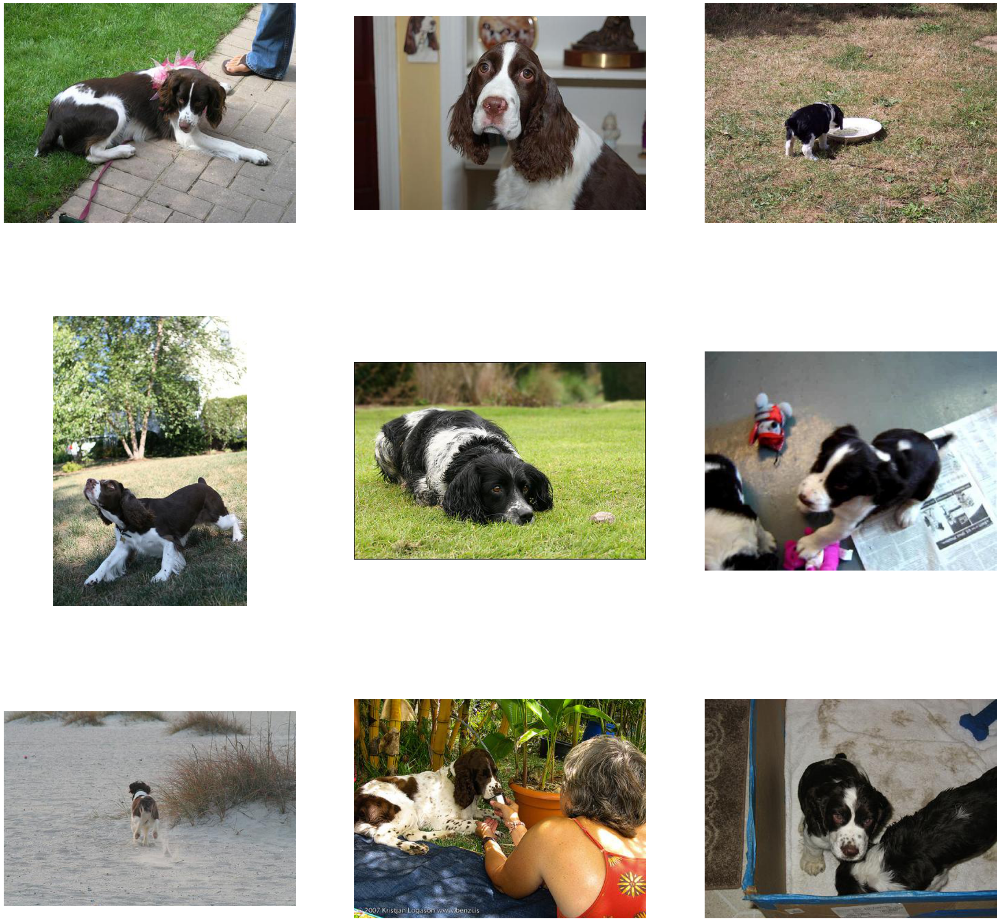

In [8]:
# select and visualize some images from the "Tench" class

selected_images = image_list_test[-9:]

f, axarr = plt.subplots(3, 3, figsize=(35, 35))
c = 0
for i in range(3):
    for j in range(3):
        axarr[i, j].imshow(image.imread(selected_images[c]))
        axarr[i, j].axis("off")
        c += 1

plt.show()

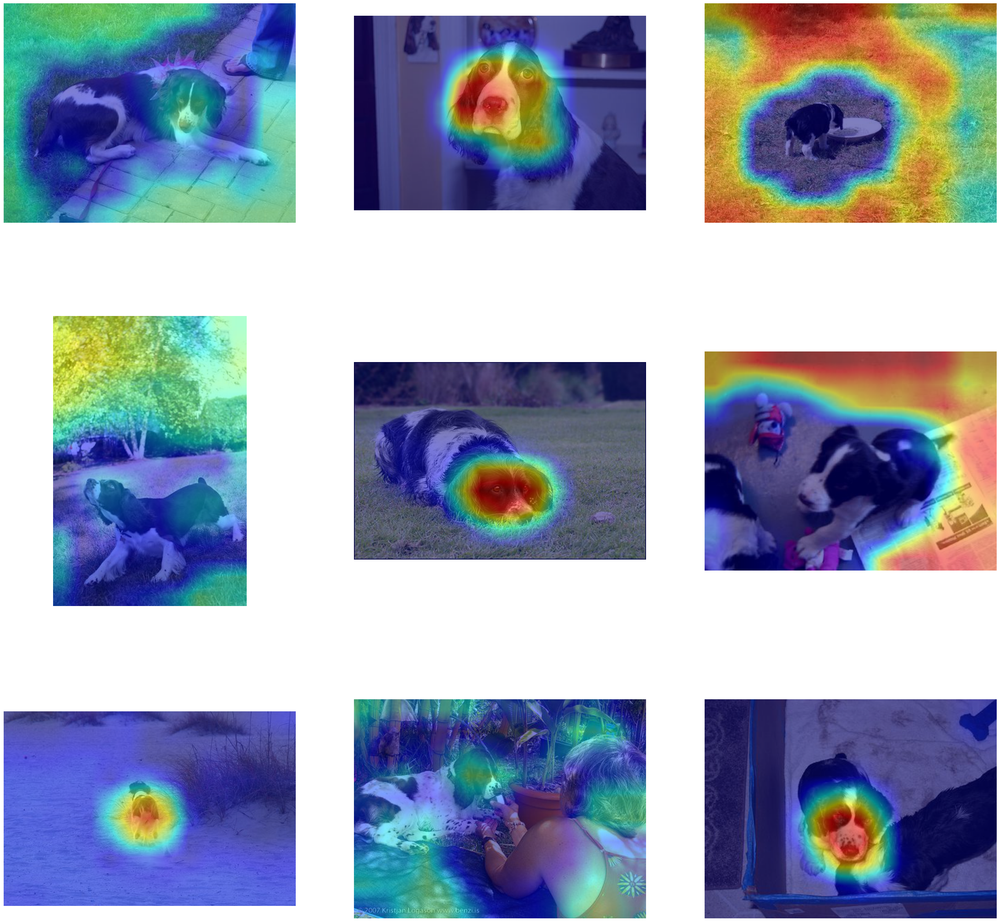

In [9]:
# visualize Grad-CAM results on same batch of images

f, axarr = plt.subplots(3, 3, figsize=(35, 35))
c = 0
for i in range(3):
    for j in range(3):

        image_test = image.imread(selected_images[c])

        input_tensor = torch.from_numpy(
            np.expand_dims(np.transpose(image_test / 255.0, (2, 0, 1)), 0).astype(
                np.float32
            )
        )
        grayscale_cam = cam(
            input_tensor=input_tensor,
            targets=targets,
            aug_smooth=True,
            eigen_smooth=True,
        )
        grayscale_cam = grayscale_cam[0, :]
        visualization = show_cam_on_image(
            np.array(
                image_test / 255,
            ).astype(np.float32),
            grayscale_cam,
            use_rgb=True,
        )

        axarr[i, j].imshow(visualization)
        axarr[i, j].axis("off")
        c += 1

plt.show()